In [1]:
from pathlib import Path
import os

from astropy.nddata import CCDData
from astropy.visualization import hist
from astropy.stats import mad_std

import ccdproc as ccdp
import matplotlib.pyplot as plt
import numpy as np
import sys
from astropy import units as u


sys.path.append("/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline")
import fpnfix
from aperturePhot import showimage as show_image

from astropy.io import fits
from astropy.wcs import WCS
from astropy.coordinates import SkyCoord
import aperturePhot as ap

In [3]:
path = "/home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/"
day = "20211110"
path_day = os.path.join(path, day)

data_red = Path(path_day, "Reduced_Images")
data_red.mkdir(exist_ok = True)

In [4]:
files = ccdp.ImageFileCollection(path_day)
files.summary['file', 'imagetyp', 'filter', 'exptime', 'naxis1', 'naxis2']

file,imagetyp,filter,exptime,naxis1,naxis2
str18,str11,object,float64,int64,int64
Ast1_001V.fit,Light Frame,Bessel V,20.0,1024,1024
Ast1_002V.fit,Light Frame,Bessel V,20.0,1024,1024
Ast1_003V.fit,Light Frame,Bessel V,20.0,1024,1024
Ast1_004V.fit,Light Frame,Bessel V,20.0,1024,1024
Ast1_005V.fit,Light Frame,Bessel V,20.0,1024,1024
Ast1_006V.fit,Light Frame,Bessel V,20.0,1024,1024
Ast1_007V.fit,Light Frame,Bessel V,20.0,1024,1024
Ast1_008V.fit,Light Frame,Bessel V,20.0,1024,1024
Ast1_009V.fit,Light Frame,Bessel V,20.0,1024,1024


In [5]:
calibrated_biases = files.files_filtered(imagetyp='Bias Frame', include_path=True)

combined_bias = ccdp.combine(calibrated_biases,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit = "adu")

combined_bias.meta['combined'] = True

combined_bias.write(os.path.join(data_red / 'combined_bias.fit'), overwrite = True)

In [6]:
calibrated_darks = files.files_filtered(imagetyp='Dark Frame', include_path=True)
reduced_darks= []
exptime= []

for frame in calibrated_darks:
    image = ccdp.CCDData.read(frame, unit = 'adu')
    exptime.append(image.header["exposure"])
    reduced_darks.append(ccdp.subtract_bias(image, combined_bias))
    
combined_darks = ccdp.combine(reduced_darks,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit = "adu", scale =1 / np.array(exptime))

combined_darks.header["exposure"] = 1
combined_darks.header['exptime'] = 1

combined_darks.meta['combined'] = True

combined_darks.write(os.path.join(data_red / 'combined_darks.fit'), overwrite = True)

In [7]:
flat_imagetyp = 'Flat Field'

flat_filters = set(h['filter'] for h in files.headers(imagetyp=flat_imagetyp))
flat_filters

{'Bessel B', 'Bessel R', 'Bessel V'}

In [8]:
scale = lambda a: 1/np.median(a)

master_flats = {}

for filt in flat_filters:
    reduced_flats = []
    calibrated_flats = files.files_filtered(imagetyp = flat_imagetyp, filter = filt, include_path=True)
    
    for flat in calibrated_flats:
        image = ccdp.CCDData.read(flat, unit = "adu")
        image = ccdp.subtract_bias(image, combined_bias)
        image = ccdp.subtract_dark(image, combined_darks, scale=True, exposure_unit=u.s, exposure_time = "exptime")
        #image = fpnfix.subtract_fpn(image,combfpn[60],mesh_size=32, verbose = 2)
        reduced_flats.append(image)
    
    combined_flats = ccdp.combine(reduced_flats,
                                 method='median',
                                 sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                                 sigma_clip_func=np.ma.median, signma_clip_dev_func=mad_std, unit = "adu", scale = scale
                                )

    master_flats[filt]=combined_flats.copy()

    combined_flats.write(data_red / (filt.replace("","_")+"_combined_flats.fit"), overwrite = True)

799.707736492157 1.4826
792.5 808.5


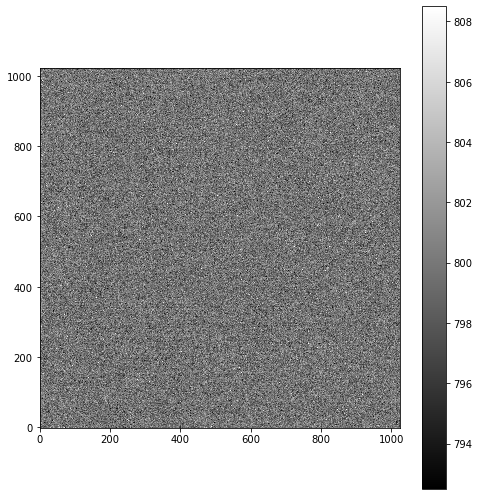

In [9]:
show_image(combined_bias)

0.14006525675455725 0.061775000000000004
-0.10833333333333334 0.5160842815095296


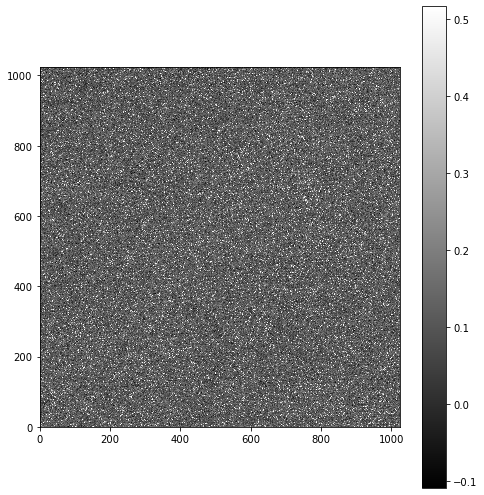

In [10]:
show_image(combined_darks)

0.9996884783744349 0.006192105671985256
0.9709101445970378 1.0191589310786293


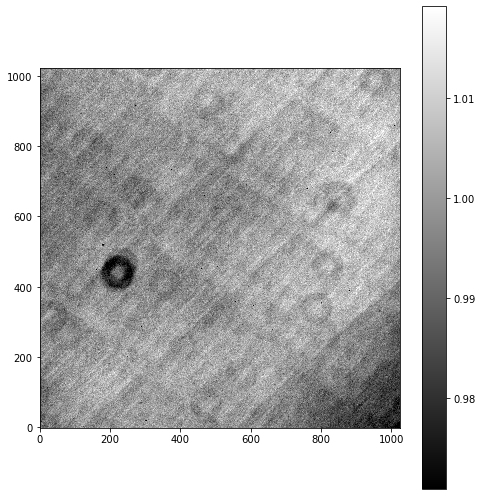

1.0000745261406319 0.005581795143502182
0.9661330805698352 1.0191864139712212


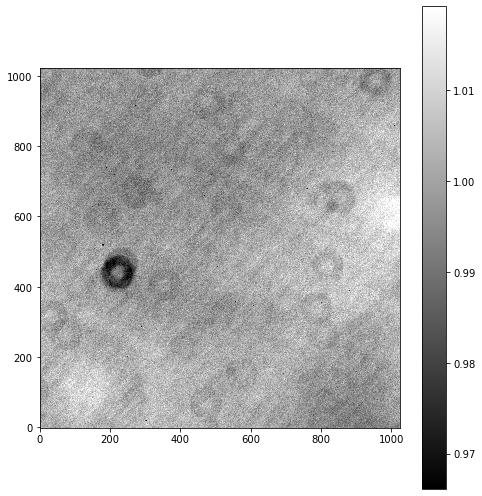

1.0004493589084391 0.006158007066087553
0.9700898159918311 1.0300268822806178


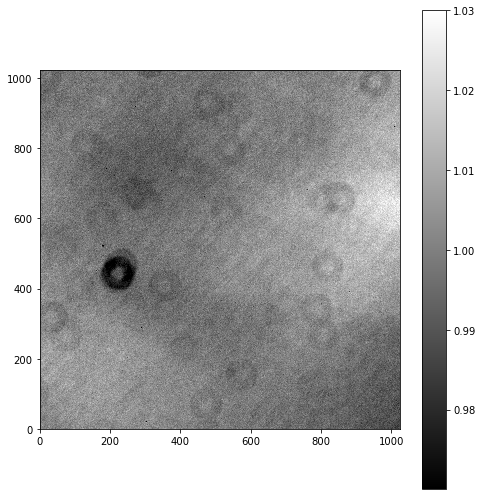

In [11]:
for filt,image in master_flats.items():
    show_image(image)

In [12]:
import ccdproc
images = files.files_filtered(imagetyp="Light Frame", include_path = True)

for image in images:
    var = ccdp.CCDData.read(image, unit = "adu")
    var_filt = var.header["filter"]
    
    corr_filt = master_flats[var_filt]
    
    var = ccdproc.ccd_process(var,
                             master_bias = combined_bias, dark_frame = combined_darks,
                             master_flat = corr_filt, exposure_key="exposure", exposure_unit = u.second,
                             dark_scale = True)
    proc_data = os.path.basename(image)
    var.write(data_red / ("BDF_"+proc_data), overwrite = True)

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
617.7417199528956 16.270783413796828
567.0639979750139 668.559051188823


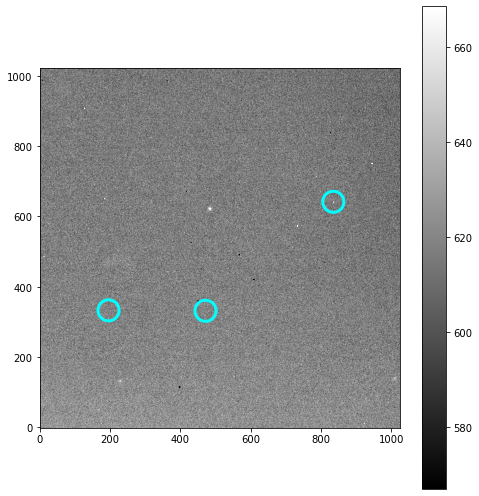

    xcentroid   ycentroid       mag
2  834.883267  641.864215 -1.049482
1  195.374239  333.020412 -0.151771
0  471.252095  331.732211 -0.010300
Point RA 23 41 55
Point Dec +44 10 39
objcoord <SkyCoord (ICRS): (ra, dec) in deg
    (355.47916667, 44.1775)>
radecstr 355.479 44.1775
Search radius = 0.13106342470013851 deg


/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:298: RuntimeWarning: divide by zero encountered in double_scalars
  scalex = 1.0/(dxfit[1]/np.cos(anglex))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:299: RuntimeWarning: divide by zero encountered in double_scalars
  scaley = 1.0/(dyfit[2]/np.cos(angley))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:301: RuntimeWarning: invalid value encountered in double_scalars
  fracanglediff = np.abs((anglex - angley)/anglex)
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:302: RuntimeWarning: invalid value encountered in double_scalars
  fracscalediff = np.abs((scalex-scaley)/scalex)
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


        ra                dec         phot_bp_mean_mag
       deg                deg               mag       
------------------ ------------------ ----------------
 355.5019035183828 44.198035374175014        10.688043
355.45682608764184   44.1091497298546        10.973479
355.64099415478967  44.12772121179612        11.496982
 355.3306982581766   44.2359279272418        11.909237
355.50456763922585  44.06754318511075        12.128365
355.47999369869643 44.170596761287726        12.559549
355.47001979053437  44.22036113755551        12.621736
 355.3698096839802  44.17781222041276        12.638292
 355.5469803797695  44.23222573087555        13.010126
 355.5136833365018 44.192329310844094        13.069663
355.52571998929113  44.25459544396694        13.205368
355.34150523232074 44.149817243497516         13.58919
 355.4217894072697  44.11604778557108        13.625631
355.50042831826903 44.048291166776814        13.703534
 355.3624371923208  44.26267631796206        13.718818
355.492055

1666.7843956760541 27.207804013381978
1584.7977984283004 1746.58242235529


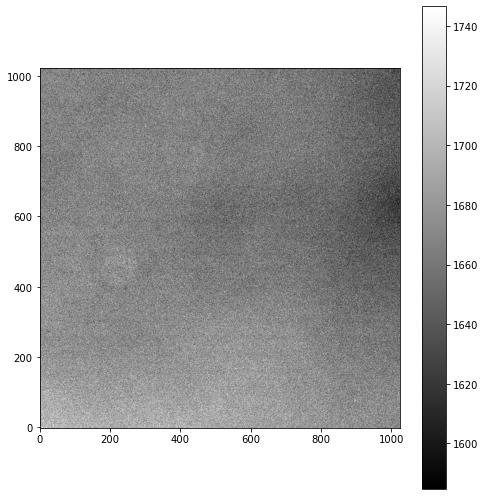

Empty DataFrame
Columns: [xcentroid, ycentroid, mag]
Index: []
Point RA 23 41 55
Point Dec +44 10 39
objcoord <SkyCoord (ICRS): (ra, dec) in deg
    (355.47916667, 44.1775)>
radecstr 355.479 44.1775
Search radius = 0.13106342470013851 deg


/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:298: RuntimeWarning: divide by zero encountered in double_scalars
  scalex = 1.0/(dxfit[1]/np.cos(anglex))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:299: RuntimeWarning: divide by zero encountered in double_scalars
  scaley = 1.0/(dyfit[2]/np.cos(angley))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:301: RuntimeWarning: invalid value encountered in double_scalars
  fracanglediff = np.abs((anglex - angley)/anglex)
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:302: RuntimeWarning: invalid value encountered in double_scalars
  fracscalediff = np.abs((scalex-scaley)/scalex)
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


        ra                dec         phot_g_mean_mag
       deg                deg               mag      
------------------ ------------------ ---------------
355.45682608764184   44.1091497298546        10.34314
355.47999369869643 44.170596761287726       10.365541
 355.5019035183828 44.198035374175014       10.528759
355.64099415478967  44.12772121179612       11.152063
 355.3306982581766   44.2359279272418       11.300747
355.50456763922585  44.06754318511075       11.603616
 355.3698096839802  44.17781222041276       12.348801
355.47001979053437  44.22036113755551       12.442065
355.52571998929113  44.25459544396694       12.642408
 355.5469803797695  44.23222573087555       12.708231
               ...                ...             ...
355.32943133886914  44.21949946113691       13.769068
 355.6486785375408 44.129677573955405       13.829346
 355.5413980430078   44.0704101181017      13.8390465
 355.5720328787715  44.08194082025348       13.874222
355.43035433548386   44.1886

1080.306887884812 22.36892467735905
1013.0690649050567 1147.828778941256


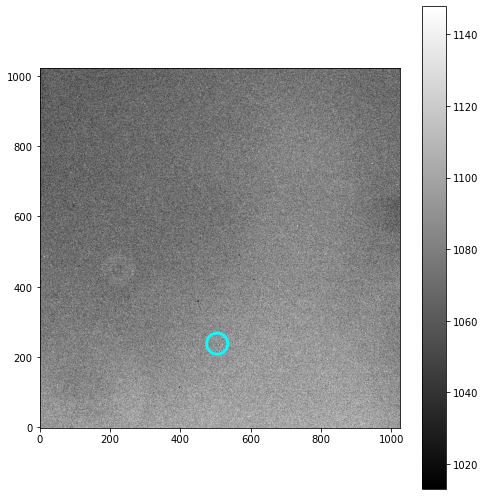

    xcentroid   ycentroid       mag
0  504.369849  238.218968 -0.080487
Point RA 23 41 55
Point Dec +44 10 39
objcoord <SkyCoord (ICRS): (ra, dec) in deg
    (355.47916667, 44.1775)>
radecstr 355.479 44.1775
Search radius = 0.13106342470013851 deg
        ra                dec         phot_g_mean_mag
       deg                deg               mag      
------------------ ------------------ ---------------
355.45682608764184   44.1091497298546        10.34314
355.47999369869643 44.170596761287726       10.365541
 355.5019035183828 44.198035374175014       10.528759
355.64099415478967  44.12772121179612       11.152063
 355.3306982581766   44.2359279272418       11.300747
355.50456763922585  44.06754318511075       11.603616
 355.3698096839802  44.17781222041276       12.348801
355.47001979053437  44.22036113755551       12.442065
355.52571998929113  44.25459544396694       12.642408
 355.5469803797695  44.23222573087555       12.708231
               ...                ...             

/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:298: RuntimeWarning: divide by zero encountered in double_scalars
  scalex = 1.0/(dxfit[1]/np.cos(anglex))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:299: RuntimeWarning: divide by zero encountered in double_scalars
  scaley = 1.0/(dyfit[2]/np.cos(angley))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:301: RuntimeWarning: invalid value encountered in double_scalars
  fracanglediff = np.abs((anglex - angley)/anglex)
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:302: RuntimeWarning: invalid value encountered in double_scalars
  fracscalediff = np.abs((scalex-scaley)/scalex)
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


Error: grmatch command failed
# Created by grmatch 0.9e0 (fi: 0.9.4)
# Invoked command: /home/idies/workspace/Storage/madisonleblanc/persistent/bin/grmatch -r /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211110/Reduced_Images/BDF_HH-And-001V.gaia.proj -i /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211110/Reduced_Images/BDF_HH-And-001V.stars.csv -o /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211110/Reduced_Images/BDF_HH-And-001V.match.csv --match-points --col-ref 4,5 --col-inp 2,3 --output-transformation /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211110/Reduced_Images/BDF_HH-And-001V.match.transform --col-ref-ordering -3 --col-inp-ordering -11 --order 1 --triangulation full,unitarity=0.001,conformable,maxnumber=100 --max-distance 2.0 --weight reference,column=3,magnitude,power=1 --comment
# Type: polynomial of order=1 (number of coefficients: 3)
type = 

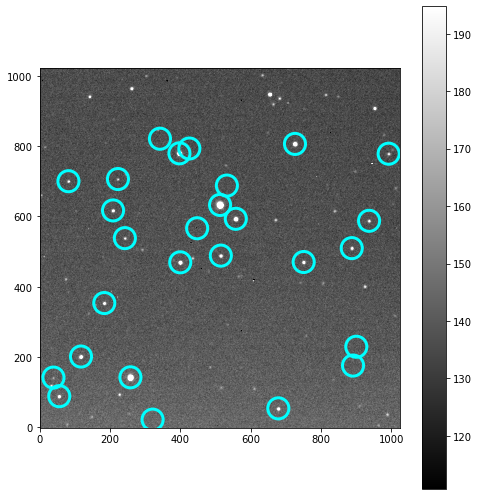

     xcentroid   ycentroid       mag
18  512.670509  632.873141 -4.602744
4   257.658760  142.461011 -3.750965
23  397.035746  779.712165 -2.814679
25  725.811929  806.477978 -2.115484
16  557.435350  593.456812 -2.054065
9   399.356260  469.594029 -1.561699
6   117.007690  201.562327 -1.371440
24  425.281924  793.455836 -0.992107
2    55.156534   88.753044 -0.855399
11  514.806181  488.693994 -0.831035
17  208.179924  617.264733 -0.766925
8   183.285095  353.752819 -0.590793
20   81.303663  700.397707 -0.509725
10  750.569817  470.531755 -0.463978
13  241.836814  538.409117 -0.426869
1   678.420236   54.157744 -0.330496
22  992.255629  778.608098 -0.275798
21  222.170349  706.543471 -0.262821
12  887.303978  509.982123 -0.224667
5   890.996636  175.878942 -0.223642
14  447.457623  566.541454 -0.219889
26  341.659646  821.269090 -0.114065
15  936.611321  587.745507 -0.090871
7   900.264887  229.390492 -0.075804
19  532.036000  688.005157 -0.065940
3    38.647389  141.667672 -0.042968
0

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
129.57363131778462 9.292343911987986
95.21655091881887 183.94862747028688


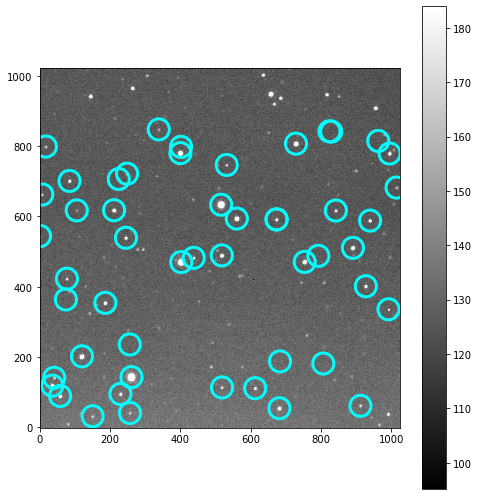

      xcentroid   ycentroid       mag
10   260.609972  143.039278 -5.409347
35   515.671936  633.498209 -4.994701
20   402.227020  470.311781 -4.677293
15   991.896548  335.948477 -3.830452
43   399.865756  780.326749 -3.307960
46   728.742890  807.194756 -2.931985
31   560.295362  594.110332 -2.866483
13   119.882139  202.190041 -2.792700
21   753.407331  470.830489 -2.027687
34   211.129574  617.853294 -1.999493
8     35.302383  118.782186 -1.893679
25   890.658980  510.779594 -1.874969
24   517.577716  489.347261 -1.674160
4     57.634434   89.401904 -1.590005
16   186.248532  354.332465 -1.467349
2    681.517205   54.586857 -1.419419
38    84.283282  701.244573 -1.257517
42   995.078612  779.171728 -1.246383
28   939.405401  588.311648 -1.180584
26   244.931070  539.469561 -0.867701
5    229.234530   95.065569 -0.796155
40   248.130838  721.853689 -0.714361
18   927.494914  401.555279 -0.702000
39   224.424729  706.710255 -0.572048
30   673.723416  591.917298 -0.494884
22   437.717

/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:298: RuntimeWarning: divide by zero encountered in double_scalars
  scalex = 1.0/(dxfit[1]/np.cos(anglex))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:299: RuntimeWarning: divide by zero encountered in double_scalars
  scaley = 1.0/(dyfit[2]/np.cos(angley))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:301: RuntimeWarning: invalid value encountered in double_scalars
  fracanglediff = np.abs((anglex - angley)/anglex)
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:302: RuntimeWarning: invalid value encountered in double_scalars
  fracscalediff = np.abs((scalex-scaley)/scalex)
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


        ra                dec         phot_g_mean_mag
       deg                deg               mag      
------------------ ------------------ ---------------
355.45682608764184   44.1091497298546        10.34314
355.47999369869643 44.170596761287726       10.365541
 355.5019035183828 44.198035374175014       10.528759
355.64099415478967  44.12772121179612       11.152063
 355.3306982581766   44.2359279272418       11.300747
355.50456763922585  44.06754318511075       11.603616
 355.3698096839802  44.17781222041276       12.348801
355.47001979053437  44.22036113755551       12.442065
355.52571998929113  44.25459544396694       12.642408
 355.5469803797695  44.23222573087555       12.708231
               ...                ...             ...
355.34559411407037  44.13051842761099      13.7032585
355.32943133886914  44.21949946113691       13.769068
 355.5413980430078   44.0704101181017      13.8390465
 355.5720328787715  44.08194082025348       13.874222
355.43035433548386   44.1886

169.8353613057029 10.15855873501645
136.40111505010236 231.97320316900698


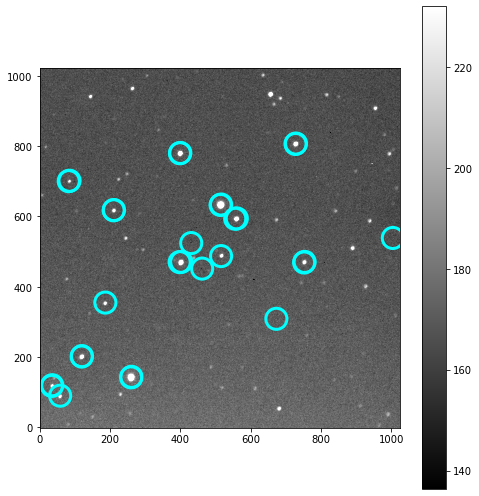

      xcentroid   ycentroid       mag
22   515.495010  634.025246 -4.059244
4    260.526637  143.789540 -3.855608
21   514.031053  632.783529 -3.627864
3    259.514372  142.261148 -3.447506
11   402.275013  470.835060 -2.298560
26   399.566331  780.714136 -2.206089
25   398.449861  779.960010 -1.817194
28   728.638806  807.602263 -1.773569
18   560.296782  594.535865 -1.636871
6    119.744805  202.668437 -1.373950
27   727.260453  806.310689 -1.248365
12   397.678065  470.161857 -0.948580
5    118.831081  201.656098 -0.879607
20   210.737263  618.373720 -0.625897
0     57.749936   90.143798 -0.601286
24    84.376561  701.794646 -0.535222
8    186.318975  355.059487 -0.503398
17   555.740523  593.590906 -0.499821
13   753.227721  470.876943 -0.498139
19   209.861493  617.642670 -0.496511
10   751.758362  469.051740 -0.448582
2     35.080832  120.022800 -0.279208
1     34.095782  117.904817 -0.247779
14   515.539843  487.362446 -0.232973
15   430.573217  524.391013 -0.194250
7    672.845

In [14]:
import plateSolve
pathlist = Path(data_red).glob('BDF_HH-And*.fit')

for path in pathlist:
    
    Rimage = ccdp.CCDData.read(path, unit="adu")
    
    check = plateSolve.autoSolve(path,Rimage, verbose = 1)
    if (check == True):
        #print(check)
        print(Rimage.header['JD-HELIO'])
        print("______________________________________________")
        
    else:
        print("!!!!!!!Plate solve did not work for", path)
        print("______________________________________________")
        print(" ")

['id', 'xcentroid', 'ycentroid', 'sharpness', 'roundness1', 'roundness2', 'npix', 'sky', 'peak', 'flux', 'mag']
Star magnitudes at reference aperture radius (4.25):
14 -8.58941073182901
2 -7.736018763765903
18 -6.654338247297393
20 -6.099853775456699
12 -5.990873811001366


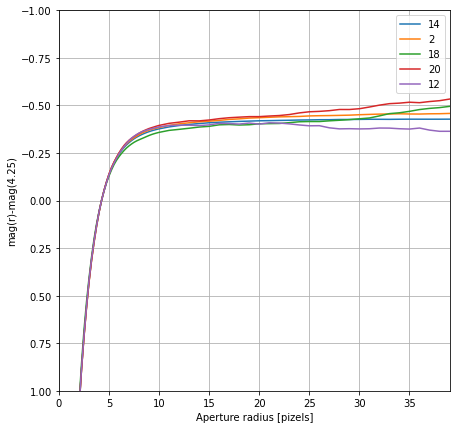

Optimum aperture:
14 7.25
2 6.25
18 5.25
20 5.0
12 5.0
23 4.5
6 4.75
4 4.5
8 4.5


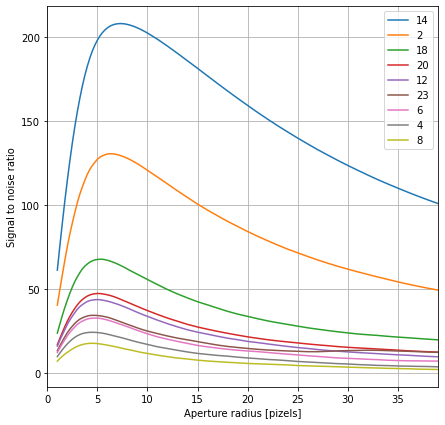

Mean optimum aperture radius = 4.5 from stars [4, 8]
Optimum aperture radius 4.5
stoppingidx 52 26.0
Systematic error from r>stopping aperture
Aperture correction: -0.39414389397918903 +/- 0.0038314225733860176
   0  -4.924 +/- 0.068 (stat) 0.004 (sys)
   1  -5.089 +/- 0.059 (stat) 0.004 (sys)
   2  -8.182 +/- 0.007 (stat) 0.004 (sys)
   3   1.827 +/- 30.108 (stat) 0.004 (sys)
   4  -5.635 +/- 0.038 (stat) 0.004 (sys)
   5  -4.986 +/- 0.064 (stat) 0.004 (sys)
   6  -6.030 +/- 0.028 (stat) 0.004 (sys)
   7  -5.061 +/- 0.060 (stat) 0.004 (sys)
   8  -5.224 +/- 0.053 (stat) 0.004 (sys)
   9  -4.833 +/- 0.072 (stat) 0.004 (sys)
  10  -4.371 +/- 0.107 (stat) 0.004 (sys)
  11     nan +/- -1.331 (stat) 0.004 (sys)
  12  -6.435 +/- 0.021 (stat) 0.004 (sys)
  13  -5.091 +/- 0.058 (stat) 0.004 (sys)
  14  -9.037 +/- 0.005 (stat) 0.004 (sys)
  15  -4.525 +/- 0.094 (stat) 0.004 (sys)
  16  -3.970 +/- 0.151 (stat) 0.004 (sys)
  17  -4.415 +/- 0.102 (stat) 0.004 (sys)
  18  -7.099 +/- 0.014 (stat) 0

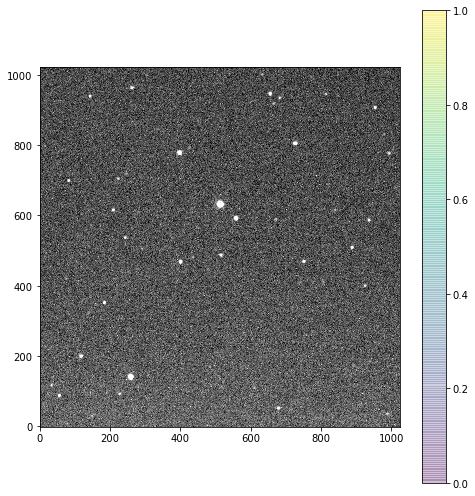

60.0
1.04526387313695


In [19]:
import warnings 

warnings.simplefilter("ignore")
os.chdir(Path(data_red))
#imR = CCDData.read("BDF_HHAnd_0000_002R.wcs.fit", unit = "adu")
imR = fits.open('BDF_HH-And-002B.wcs.fit')

#Find stars in the image
sources, bgplane= ap.findStars(imR)

#Generate a growth curve (i.e., measure fluxes at a range of aperture 
#sizes for all stars)
rap,mag,err,apers = ap.growthCurve(imR,sources)

#Plot the growth curve - use this to pick stars to use when calculating 
#the aperture correction
ap.plotGrowth(rap,mag,err,figsize=(7,7))
useForAppCorr = [2]
stoppingApertureRadius = 26.0

#Plot the SNR curve for a chosen star(s) and estimate the optimum aperture
ap.plotSNR(rap,mag,err,Nbrightest=9,figsize=(7,7))

#Apply an aperture correction for a chosen optimal aperture radius
imag,ierr,isys,apCorr = ap.apertureCorrection(rap,mag,err,optap=[4,8],
                                              stoppingAperture=stoppingApertureRadius,
                                              stars=useForAppCorr)


for i,m in enumerate(imag):
    print('%4d %7.3f +/- %5.3f (stat) %5.3f (sys)' % (sources['id'][i]-1,m,ierr[i],isys))

imag
ap.showimage(imR[0].data,stars=sources)
print(imR[0].header['EXPOSURE'])
print(imR[0].header["AIRMASS"])

In [20]:
xpix = sources["xcentroid"][6]
ypix = sources["ycentroid"][6]
w = WCS(imR[0].header)
#Rstarxy = np.transpose((sources['xcentroid'],sources['ycentroid']))
#radec = w.all_pix2world(Rstarxy,1)
sky =w.pixel_to_world(xpix,ypix)
print(sky)

<SkyCoord (ICRS): (ra, dec) in deg
    (355.48026984, 44.16790561)>


['id', 'xcentroid', 'ycentroid', 'sharpness', 'roundness1', 'roundness2', 'npix', 'sky', 'peak', 'flux', 'mag']
Star magnitudes at reference aperture radius (5.25):
19 -9.384010586650426
20 -9.349021596199897
3 -9.213715359748278
4 -9.193147531418527
10 -7.5599214323524455


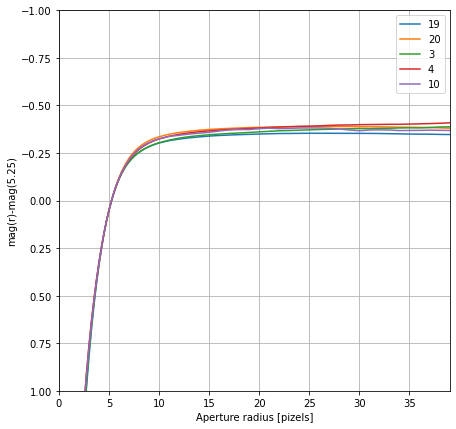

Optimum aperture:
19 7.75
20 8.0
3 7.5
4 7.75
10 6.25
23 5.75
24 6.0
11 7.5
25 6.0


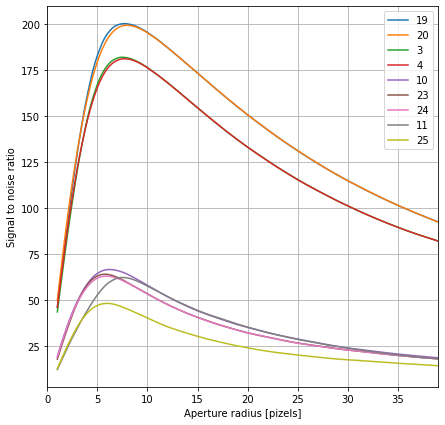

Mean optimum aperture radius = 6.083333333333333 from stars [25, 24, 10]
Optimum aperture radius 6.0
stoppingidx 52 26.0
Systematic error from r>stopping aperture
Aperture correction: -0.26837104532888567 +/- 0.0027677302420378094
   0  -5.987 +/- 0.062 (stat) 0.003 (sys)
   1  -5.916 +/- 0.066 (stat) 0.003 (sys)
   2  -5.916 +/- 0.066 (stat) 0.003 (sys)
   3  -9.594 +/- 0.005 (stat) 0.003 (sys)
   4  -9.577 +/- 0.005 (stat) 0.003 (sys)
   5  -6.975 +/- 0.028 (stat) 0.003 (sys)
   6  -6.949 +/- 0.028 (stat) 0.003 (sys)
   7     nan +/- -3.782 (stat) 0.003 (sys)
   8  -5.935 +/- 0.065 (stat) 0.003 (sys)
   9  -6.351 +/- 0.046 (stat) 0.003 (sys)
  10  -7.945 +/- 0.014 (stat) 0.003 (sys)
  11  -7.767 +/- 0.016 (stat) 0.003 (sys)
  12  -6.393 +/- 0.044 (stat) 0.003 (sys)
  13  -6.112 +/- 0.056 (stat) 0.003 (sys)
  14     nan +/- -1.103 (stat) 0.003 (sys)
  15  -7.227 +/- 0.023 (stat) 0.003 (sys)
  16  -7.387 +/- 0.020 (stat) 0.003 (sys)
  17  -6.243 +/- 0.050 (stat) 0.003 (sys)
  18  -6.23

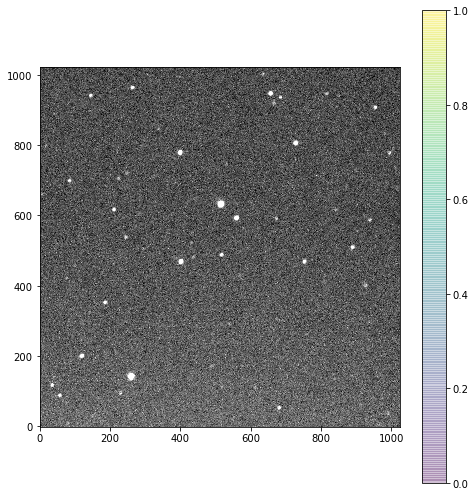

30.0
1.04448709410588


In [22]:
os.chdir(Path(data_red))
#imR = CCDData.read("BDF_HHAnd_0000_002R.wcs.fit", unit = "adu")
imR = fits.open('BDF_HH-And-002V.wcs.fit')

#Find stars in the image
sources, bgplane= ap.findStars(imR)

#Generate a growth curve (i.e., measure fluxes at a range of aperture 
#sizes for all stars)
rap,mag,err,apers = ap.growthCurve(imR,sources)

#Plot the growth curve - use this to pick stars to use when calculating 
#the aperture correction
ap.plotGrowth(rap,mag,err,figsize=(7,7))
useForAppCorr = [20]
stoppingApertureRadius = 26.0

#Plot the SNR curve for a chosen star(s) and estimate the optimum aperture
ap.plotSNR(rap,mag,err,Nbrightest=9,figsize=(7,7))

#Apply an aperture correction for a chosen optimal aperture radius
imag,ierr,isys,apCorr = ap.apertureCorrection(rap,mag,err,optap=[25,24,10],
                                              stoppingAperture=stoppingApertureRadius,
                                              stars=useForAppCorr)

for i,m in enumerate(imag):
    print('%4d %7.3f +/- %5.3f (stat) %5.3f (sys)' % (sources['id'][i]-1,m,ierr[i],isys))

imag
ap.showimage(imR[0].data,stars=sources)
print(imR[0].header['EXPOSURE'])
print(imR[0].header["AIRMASS"])

In [24]:
xpix = sources["xcentroid"][10]
ypix = sources["ycentroid"][10]
w = WCS(imR[0].header)
#Rstarxy = np.transpose((sources['xcentroid'],sources['ycentroid']))
#radec = w.all_pix2world(Rstarxy,1)
sky =w.pixel_to_world(xpix,ypix)
print(sky)

<SkyCoord (ICRS): (ra, dec) in deg
    (355.48036416, 44.1680223)>
